# Exploring the Air Quality of the San Francisco Bay Area using OpenAQ #

### STAT 159/259 Final Project ###
Authors: Wesley Darling, Gyuhyeon Seo, Ram Kripa, Jae Hee Koh

## Project Motivation ##

On September 9th, 2020, in the midst of the COVID-19 pandemic and wildfires up and down the State of California, residents of the San Francisco Bay Area woke up to a shocking sight: 

<center><img src="https://s.hdnux.com/photos/01/14/04/25/19940696/15/rawImage.jpg" width="700" height="700" /></center>

The smoke from the multiple wildfires taking place inland had been carried by air currents into the Bay Area, causing the sunlight to refract and obscure in a way that made the sky orange. For those of us that were in the Bay Area on that day, it's impossible to forget the experience of waking up and expecting the lovely California sunshine and instead finding yourself waking to a hellish-looking sky. So often we forget about what air quality truly means, going about our day and taking it for granted. That day was a wakeup call that, if we continue to neglect our environment in the way we have been, days like September 9th, 2020 may become all the more common. In fact, poor air quality is the leading cause of death for more than 1 in 8 people, and air pollution is the [4th largest risk factor to human health worldwide](https://openaq.org/#/why). It is of the utmost importance that air and the factors negatively affecting its quality be sufficiently monitored and understood by those who breath it (i.e., *__everyone__*). 

## Introduction ##

With this motivation in mind, we decided to focus the work of our project on exploring the air quality of the San Francisco Bay Area, taking a look at that specific Dark Day (9/9/2020) as well as the current air quality status of the area. For this project, we used the [OpenAQ dataset](https://openaq.org/#/), a repository of air quality data collected from 49,000 locations worldwide that is freely available and open to the public. Using the [`py-openaq` module](https://github.com/dhhagan/py-openaq) to easily make data requests from the OpenAQ API and a variety of utility functions we developed ourselves (available in the `aq tools` folder), we explored, visualized, and analyzed OpenAQ data related to the San Francisco Bay Area. We chose to focus on the Bay Area for tractability purposes (it limits the number of API calls necessary -- requesting data for the entire USA led to issues with overwhelming the API) and because it is a location both with which we are familiar and of which we care about the well-being. This report begins with an exploration of the data available and then continues into a visualization of the air quality in several locations of the Bay Area, as well as the entire Bay Area and State of California during the days surrounding 09/09/2020. Following the data exploration and visualization, an analysis of the OpenAQ data is presented. The report ends with concluding remarks and a statement on the authors' contributions. 

## Data Exploration ##

When requested, data from OpenAQ arrives in the JSON format, which allows one to easily parse it into a Pandas DataFrame for analysis. An example of the parameters that come with each JSON packet are shown below for the San Francisco Air Quality Sensing Location. The air quality parameters available to explore are CO (carbon monoxide), NO<sub>2</sub> (Nitrogen Dioxide), PM<sub>2.5</sub> (fine particulate matter that is 2.5 microns or less), and O<sub>3</sub> (Ozone). 


In [16]:
import pandas as pd; pd.read_pickle('data/paramdf.pkl')

,San Francisco AQ Parameters
id,2009
country,US
city,San Francisco-Oakland-Fremont
cities,[San Francisco-Oakland-Fremont]
location,San Francisco
locations,[San Francisco]
sourceName,AirNow
sourceNames,[AirNow]
sourceType,government
sourceTypes,[government]


As stated previously, we intend to focus our analysis on the San Francisco Bay Area. By filtering the OpenAQ dataset with the Bay Area as our region, we focus our data exploration at the locations in the image below.

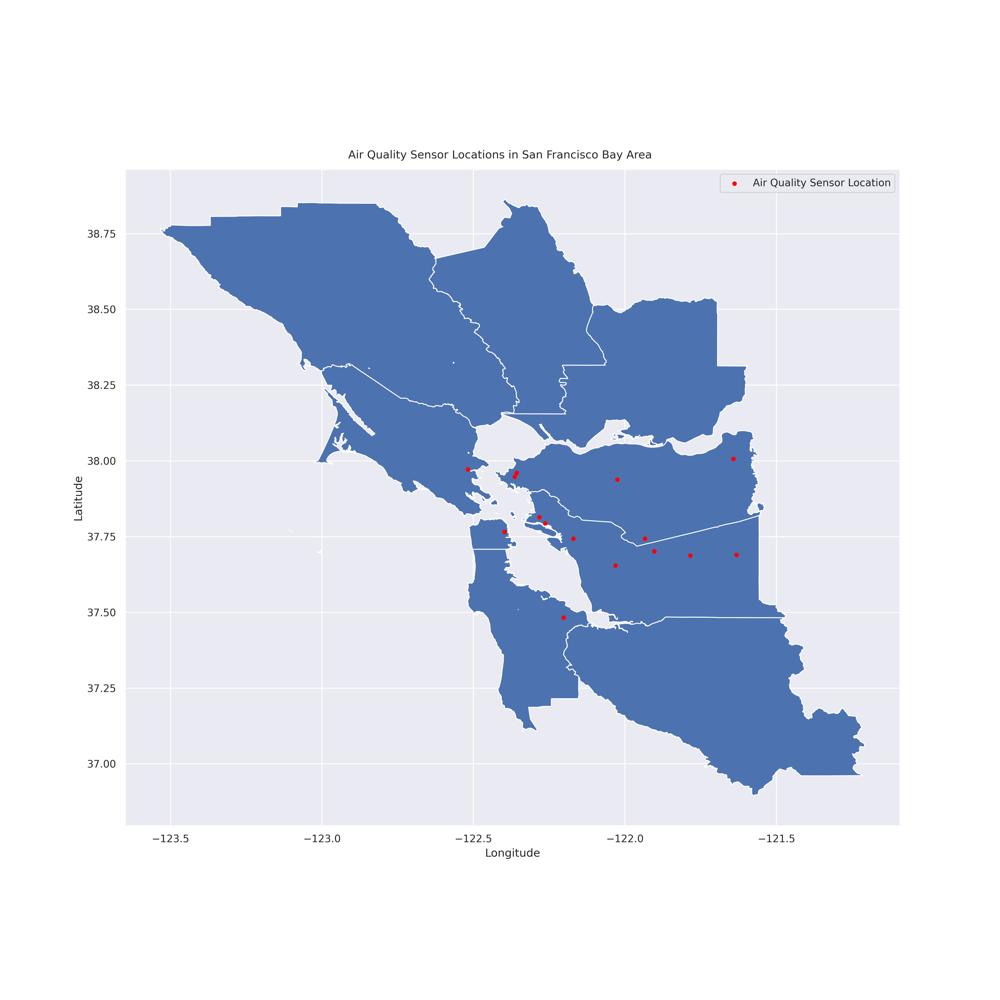

In [17]:
from IPython.display import Image; Image(filename = "figures/BAgeog.png", width=1000, height=1000)

Taking a look at data from the past week (5/3/2022 to 5/10/2022) in the Bay Area, we see the following statistical information about the parameters. Clearly, the fine particulate matter (PM<sub>2.5</sub>) exhibits the most variance. In the boxplots below it is even easier to see this variance. 

PM<sub>2.5</sub> can be particularly dangrous as it can cause short-term health effects such as eye, nose, and lung irritation, coughing, sneezing, and shortness of breath, and long-term exposure (months to years) has been [linked to premature death](https://nepis.epa.gov/Exe/ZyPDF.cgi/P100RQ5N.PDF?Dockey=P100RQ5N.PDF). Because of its importance in evaluating air quality indicators, PM<sub>2.5</sub> will be the focus of our exploration.

In [11]:
pd.read_pickle('data/weekstatsdf.pkl')

,min,25th percentile,median,mean,75th percentile,max
parameter,,,,,,
bc,0.020,0.090,0.200,0.244613,0.315,1.170
co,0.120,0.220,0.280,0.312877,0.370,0.790
no2,0.000,0.002,0.004,0.005016,0.006,0.036
o3,0.003,0.025,0.034,0.032220,0.039,0.063
pm25,-3.000,4.000,6.000,6.339687,8.000,43.000
so2,-0.001,0.000,0.000,0.000491,0.001,0.012


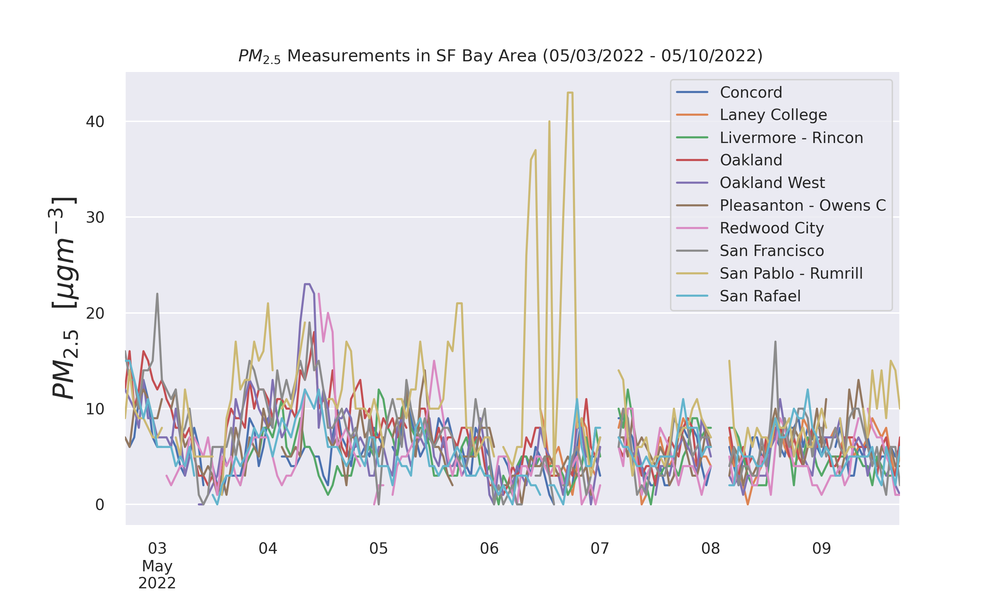

In [4]:
Image(filename = 'figures/PM25TSthisweek.png', width=1000, height=1000)

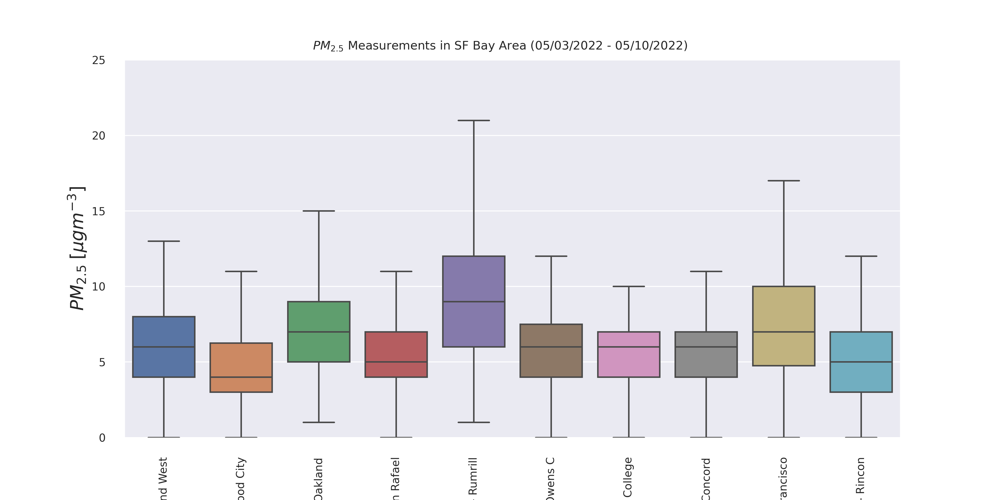

In [5]:
Image(filename = 'figures/PM25Boxthisweek.png', width=1000, height=1000)

The data for this past week is especially interesting when we consider it in the context of the days surrounding the "dark day" (September 9, 2020). The time series graph above with the peak PM<sub>2.5</sub> of 43 $\mu gm^{-3}$ seems high, but considering the peak during the wildfire period was greater than 200 $\mu gm^{-3}$ (as pictured below) it puts it in a new perspective.

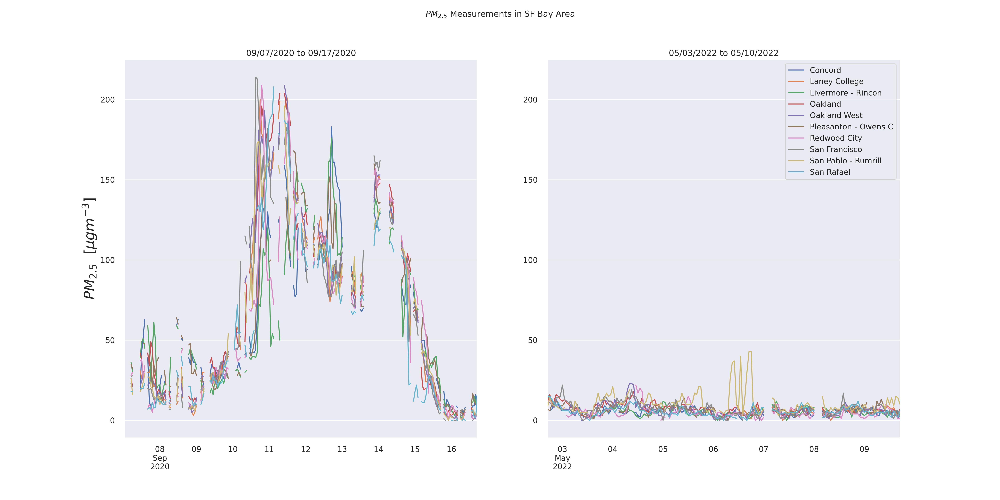

In [6]:
Image(filename = 'figures/PM25TScompare.png', width=1000, height=1000)

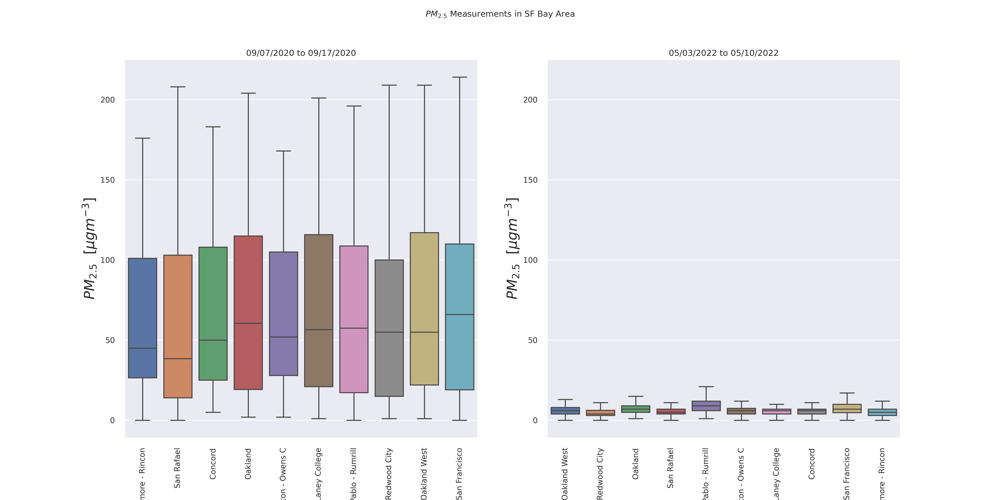

In [7]:
Image(filename = 'figures/PM25Boxcompare.png', width=1000, height=1000)

It is also interesting to see that the peak PM<sub>2.5</sub> during the wildfire period does *__not__* occur on the so-called "dark day" itself. This fact is made even more clear by focusing on one specific data sensor, that which is located in San Francisco and is operated by the Bay Area Air Quality Management District (BAAQMD). 

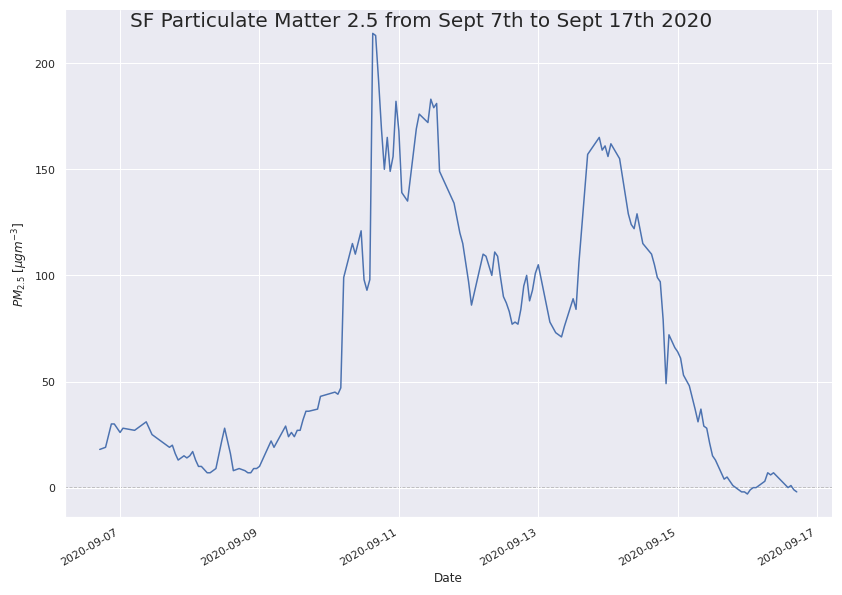

In [8]:
Image(filename = 'figures/SFTS.png', width=1000, height=1000)

Not only did the peak PM<sub>2.5</sub> occur a day or more after the "dark day" but that after falling from its peak, the particulate matter increased once again to nearly the same amount. This is interesting to learn for several reasons. First and foremost, there is a clear delay between when people on the ground "saw" their poor air quality and when the sensor "saw" the poor air quality. This is likely because on the "dark day" the particulates were likely high in the sky at a height much greater than that of the air quality sensors, which tend to be located either a few feet above the surface, or on the top of a building as pictured below. This is understandable, as the air quality sensors aim to provide air quality index (AQI) information about the air people will actually be breathing. Depending on the individual, however, one might heed air quality issues only when they can actually them. For example, a person on the "dark day" was likely to wear a facemask because the amount of air pollution they can see in the sky and would thus imagine they could be breathing it in on the ground (as well as because of the COVID-19 pandemic). On the otherhand, a couple of days after the dark day, when the sky appears more visible, but the ground-level air quality is actually lower, could lead to individuals being outside without a face mask because they cannot "see" the poor air quality themselves. Though this challenge is beyond the scope of this analysis, it is an interesting predicament.

 <center><img src="https://ww2.arb.ca.gov/sites/default/files/styles/list/public/images/AirMonitoring-20.jpg?h=180281fb&itok=ypZzf_Vf" width="350" height="350" /></center>
 
The second interest aspect of this finding is the fact that, several days after the "dark day" the air quality seemingly returns back to normal. This begs the question -- **What happened to the poor quality air? Did it settle on the ground in the Bay Area, or did wind/air currents carry it to a different part of the Bay Area (or even a different part of California)?** This will the be the focus of the visualization section of this write-up. 

The full code for the Data Exploration section can be found in the [ExplorationAndVisualization.ipynb Jupyter Notebook](ExplorationAndVisualization.ipynb).

## Visualization of SF Bay Area Air Quality During Wildfire Period (09/07/2020 to 09/17/2020) ##

To visualize the air quality of the San Francisco Bay Area during the wildfire period, we can start by looking at the PM<sub>2.5</sub> at each sensor location. We can see in the gif below that the particulates seem to move into San Francisco on the 9th, reach their peak at the 10th, move towards the East Bay with a peak there by the 12th, before moving back towards San Francisco by the 13th for a second peak, before dissipating in the entire Bay Area by the 16th. 

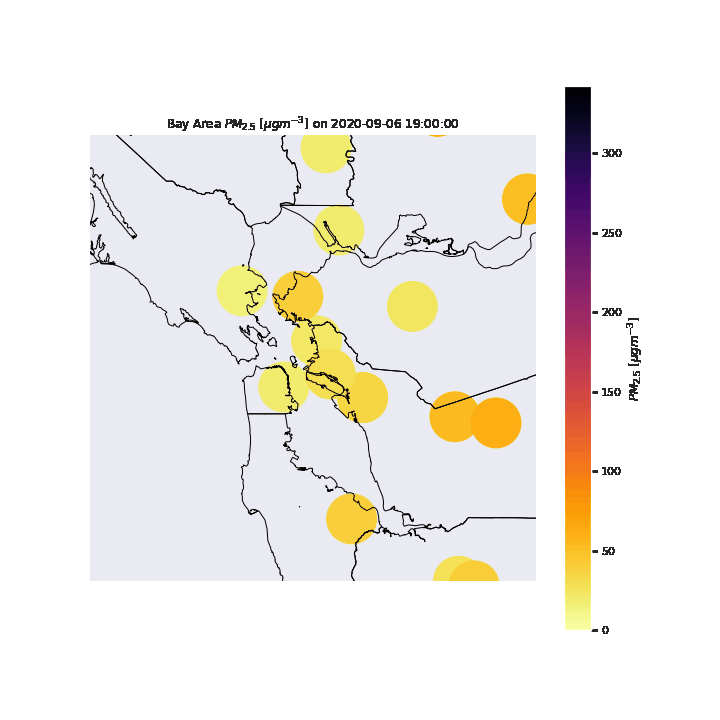

In [15]:
with open('figures/simpletimelapsegif.gif','rb') as file:
    display(Image(file.read()))

We can refine this visualization by increasing the time steps from daily to hourly point measurements, and interpolating between points to form smooth contours. For the purposes of this visualization, we assume a linear interpolation between spatial and temporal points (when data at specific sensors was not available. From this new visualization, we can see the effects air currents have on the particulate measurements throughout the day. Once again, we see the particulates move in from the east, however in this new visualization, we can see that the particulates move from the San Francisco Peninsula to the South Bay towards the end of the day of the 11th. The particulates then move back north to San Francisco and the Berkeley/Oakland part of the East Bay before continuing east where it dissipates.

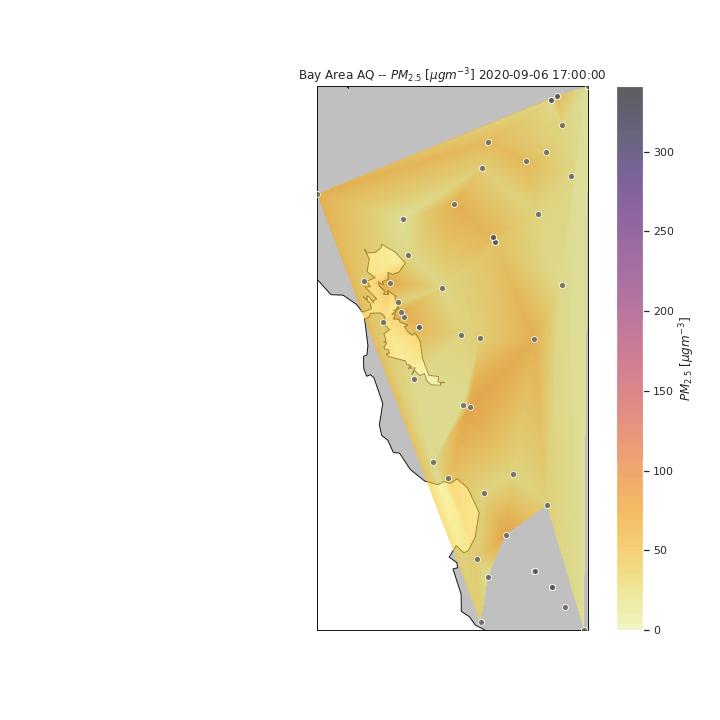

In [12]:
with open('figures/timelapsegif.gif','rb') as file:
    display(Image(file.read()))

In the above visualization, we see the particulates move towards the South and East parts of the Bay Area after the initial peak near San Francisco. To see how the rest of the State of California was potentiall impacted by the particulates, we expand our visualization to include the rest of the state, as well as sensors in nearby states (e.g., Las Vegas). Several attempts were made to pull data for the entire United States to see the potential nation-wide impacts of the wildfire-related low air quality, however the API became throttled from too many consecutive requests.


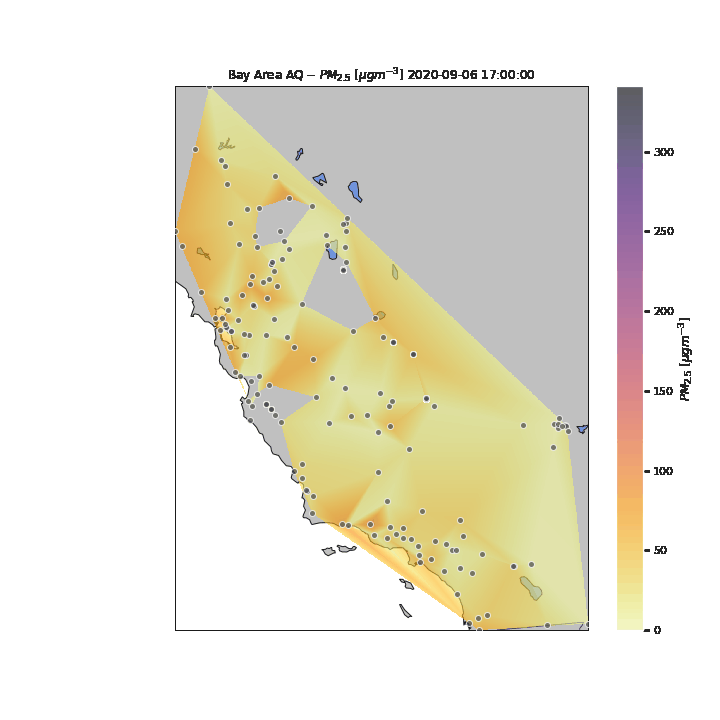

In [13]:
with open('figures/CAtimelapsegif.gif','rb') as file:
    display(Image(file.read()))

Unfortunately, due to the lack of granularity in the data, the missing areas created from missing datapoints for multiple days, and the requisite linear interpolation between points, it is difficult to perceive specific patterns in the changes in air quality for the State during the period of analysis. One key reason for this is the tragic and unfortunate fact that [numerous wildfires were occuring simultaneously](https://www.fire.ca.gov/incidents/2020/) in multiple parts of the State during the period of analysis. This is an interesting unintended feature of this visualization -- that you can visualize where wildfires were located around the State and their multiple areas of influence.

The full code for creating the animations for the Data Visualization section can be found in the [ExplorationAndVisualization.ipynb Jupyter Notebook](ExplorationAndVisualization.ipynb).

## Analysis I: Dark Days- Their occurence and prediction ##

On Sep 9 2020, San Francisco experienced a dark day when the sky turned orange. Using data from the San Francisco AQ station, we wanted to see if this could be noticed in PM2.5 and CO concentration data, especially around the ASO timeframe (August September October).


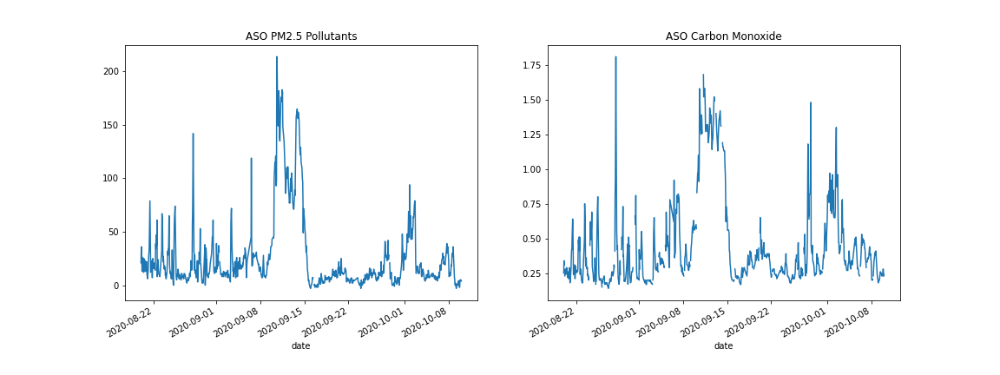

In [3]:
Image(filename = 'figures/pm25_co_aso.png', width=1000, height=1000)

We see a clear spike in PM2.5 Data but in the CO data, there are gaps and other peaks, possibly due to confounding factors such as wind. Instead, it made sense to search for a consistently high value of PM2.5 and CO concentration, which indicated using a 5 day rolling mean.

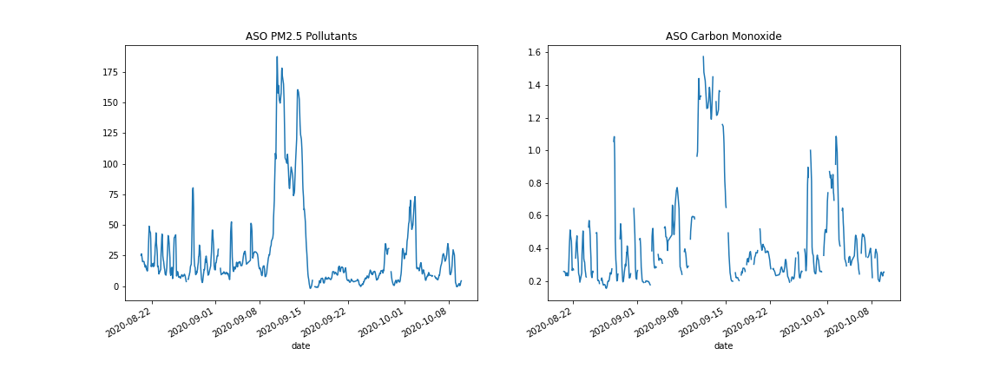

In [4]:
Image(filename = 'figures/pm25_co_rolling_aso.png', width=1000, height=1000)

This would seem to give us the spike we expect, but there are still far more missing values in the CO dataset than in the PM2.5. Since linear interpolation used in other analyses seemed too simplistic, the idea of inferring CO from PM2.5 was created and executed.

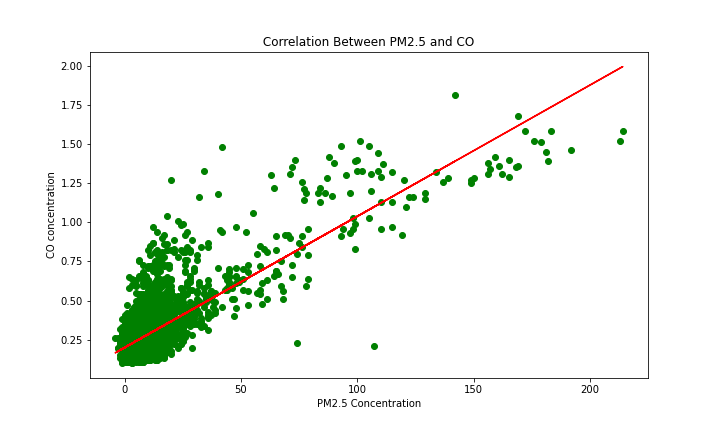

In [5]:
Image(filename = 'figures/pm25_co_corr.png', width=1000, height=1000)

The linear model seemed to fit the data and hence it was used to fill in the missing values in the CO dataset. This approach was compared with linear interpolation, and they seemed to give fairly similar results.

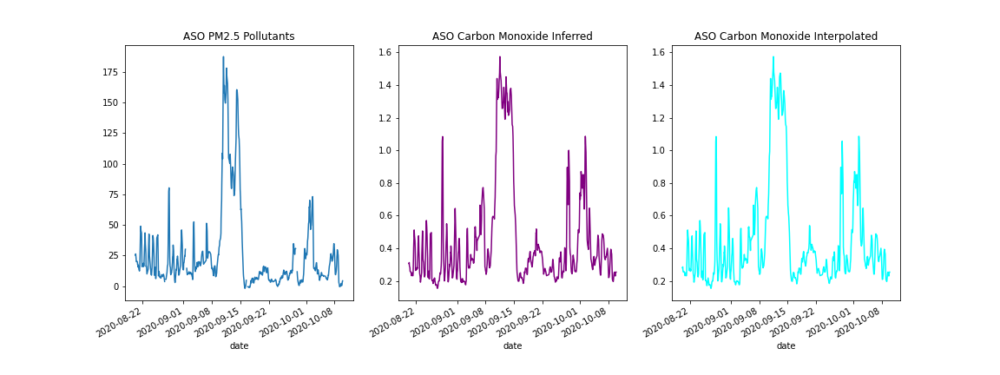

In [11]:
Image(filename = 'figures/pm25_co_compare_interps.png', width=1000, height=700)

After changing the interpolation, and verifying that the orange skies can be seen in CO and PM2.5 data, we wanted to see whether the orange skies were an isolated event, or a predictable yearly occurence. This necessitated checking other years' data in the ASO period. No other year had such a sustained period of Co and PM2.5 Concentration.

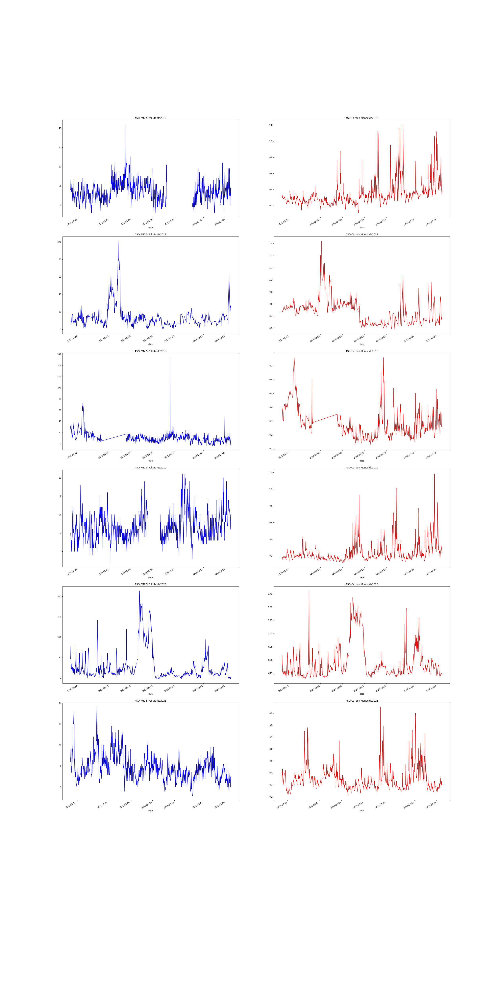

In [13]:
Image(filename = 'figures/pm25_co_across_years.png', width=1000, height=1000)

## Analysis II: Predicting Concentrations of PM<sub>2.5</sub> ##

In the Data Exploration and Visualization sections above, it is clear that there are multiple sensor locations that do not measure PM<sub>2.5</sub>. Due to its importance as a metric for air quality,  the goal of this second analysis is to explore how PM<sub>2.5</sub> concentrations can be predicted based on the concentrations of other pollutants, as well as atmospheric factors like wind speed and relative humidity. Neural Networks were selected as the machine learning method to develop the predictive algorithm. Air quality data was queried from the OpenAQ API for the Oakland Air Quality Station for the period of 09/01/2021 to 03/01/2022. Atmospheric data was queried from the NOAA API for the same location and date range. Approximately 10% of the dataset was reserved for model testing, while the other 90% was used for model training and validation.


#### Gated Recurrent Unit (GRU)
<center><img src="https://miro.medium.com/max/1400/1*yBXV9o5q7L_CvY7quJt3WQ.png" width="500" height="300" /></center>

**Long Short Term Memory (LSTM) and Gated Recurrent Unit (GRU)**<br>
(Image from https://towardsdatascience.com/illustrated-guide-to-lstms-and-gru-s-a-step-by-step-explanation-44e9eb85bf21)

Gated recurrent unit (GRU) was introduced by Cho, et al. (2014)  to solve the vanishing gradient problem faced by recurrent neural networks (RNN). In GRU, there are two gates: update gate, reset gate. These gates learn which data from the previous sequence is important to be kept or thrown away, during the training process. Since GRU uses less training parameter compared to LSTM, it is  faster than LSTM and takes up less memory.

A first predictive model using Gated Recurrent Unit Neural Network was developing using only air quality data (i.e., predicting the PM<sub>2.5</sub> concentration based on the concentrations of CO, NO<sub>2</sub>, and O<sub>3</sub>. First the air quality data were scaled and made stationary using the differencing technique, as shown in the figures below.

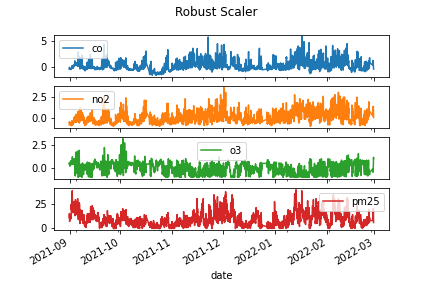

In [19]:
Image(filename = 'figures/scaling_ver1.png')

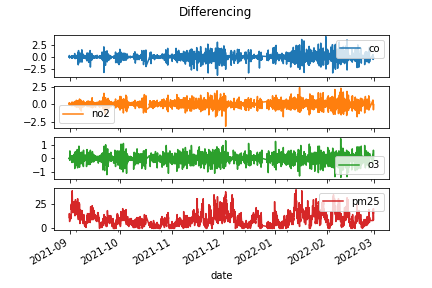

In [21]:
Image(filename = 'figures/differencing_ver1.png')

From the correlation table below, we can see that PM<sub>2.5</sub> has a slight negative correlation with CO and NO<sub>2</sub> and a slight positive correlation with O<sub>3</sub>. This could potentially mean that when CO and NO<sub>2</sub> are higher in magnitude, PM<sub>2.5</sub> concentration is lower, and when O<sub>3</sub> is high, PM<sub>2.5</sub> concentration is also high. That said, the correlations are so small that there is likely very little statistical connection between the quantities.

In [24]:
pd.read_csv('tables/correlation_ver1.csv', index_col=0)

,co,no2,o3,pm25
co,1.000000,0.673827,-0.623135,-0.118771
no2,0.673827,1.000000,-0.770821,-0.113108
o3,-0.623135,-0.770821,1.000000,0.080400
pm25,-0.118771,-0.113108,0.080400,1.000000


The figure below presents the first model's prediction outcome based on the other air quality parameters. As we can see, in a coarse way, the model predicts the general sinusoidal shape of the concentrations, however, the individual timestep values are less informative.

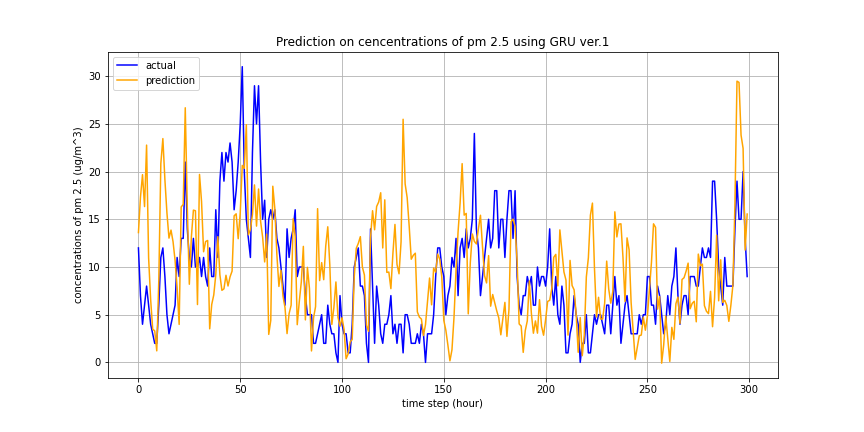

In [25]:
Image(filename = 'figures/prediction_results_ver1.png')

A second model was developed to capture additional exogenous factors that might impact the concentration of particulate matter affecting air quality, namely conditions of the surrounding atmosphere like windspeed and relative humidity. Weather data was pulled from the NOAA API, and missing values were filled with the median value. One limitation with the data pulled from the NOAA API is that the API only made the previous seven days worth of data available for querying. For this reason, the second predictive model had a much smaller training dataset available. 

Once again, before model training, data were scaled and made stationary via the differencing method, as shown in the figures below.

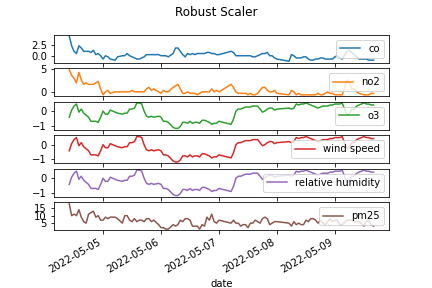

In [26]:
Image(filename = 'figures/scaling_ver2.png')

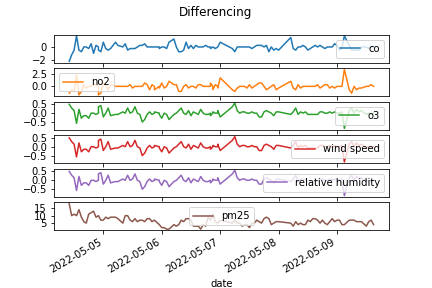

In [27]:
Image(filename = 'figures/differencing_ver2.png')

As shown in the correlation table below, PM<sub>2.5</sub> has the same relationships with the other pollutants as found in the previous training dataset. In the new training dataset, there is a positive correlation between PM<sub>2.5</sub> and wind speed as well as between PM<sub>2.5</sub> and relative humidity and PM<sub>2.5</sub>. One limitation with the dataset is that wind speed and relative humidity are directly correlated with one another. In this sense, either wind speed *or* relative humidity could be selected as a feature, as each possesses the same explanatory power as the other. 

In [28]:
pd.read_csv('tables/correlation_ver2.csv', index_col=0)

,co,no2,o3,wind speed,relative humidity,pm25
co,1.000000,0.682810,-0.638174,-0.638174,-0.638174,-0.284579
no2,0.682810,1.000000,-0.780167,-0.780167,-0.780167,-0.259517
o3,-0.638174,-0.780167,1.000000,1.000000,1.000000,0.193921
wind speed,-0.638174,-0.780167,1.000000,1.000000,1.000000,0.193921
relative humidity,-0.638174,-0.780167,1.000000,1.000000,1.000000,0.193921
pm25,-0.284579,-0.259517,0.193921,0.193921,0.193921,1.000000


A neural network with the Gated Recurrent Unit mechanism was once again used to predict PM<sub>2.5</sub> concentrations from other air quality parameters and from atmospheric conditions.  The predicted results of the second model on the testing data are presented below.

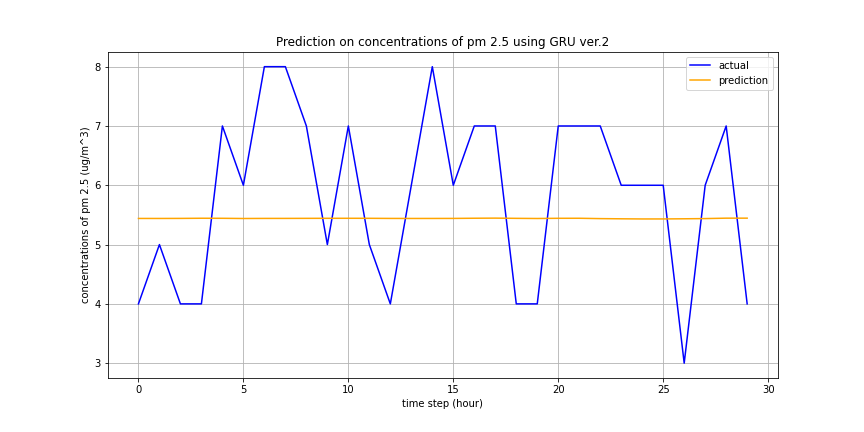

In [29]:
Image(filename = 'figures/prediction_results_ver2.png') 

As can be seen in the figure above, the second model fails to capture the periodic/sinusoidal nature of PM<sub>2.5</sub> concentrations throughout the day. This can most likely be attributed to the lack of available atmospheric data. Because the NOAA API was used, only current data could be used for training/testing. Additionally, this limited, 7-day dataset did not include all hourly measurements. Because the missing values were filled with the median, this likely led to the perfect correlation between wind speed and relative humidity, reducing the explanatory power of either feature. 

Future work on predicting PM<sub>2.5</sub> concentrations will be necessary to build upon these preliminary analyses. A future implementation could include additional other atmospheric factors, and could be based on historical data requested by email by NOAA, to ensure that a large enough training set is available for the model. Additionally, given the periodic nature of the PM<sub>2.5</sub> concentration, statistical analysis tools from the field of time series analysis could be applied, specifically multivariate autoregressive models, multivariate linear Gaussian particle filters, or Monte Carlo Markov Chain methods. Given the importance of measuring and predicting the potentially dangerous PM<sub>2.5</sub> levels, the models found in this analysis should serve as but a stepping off point for more in-depth air quality research.

## Conclusion ##

Throughout this report, we have analyzed the Bay Area air quality data from September 7th to 17th of 2020, dates surrounding the "dark day" that covered the skies with an orange tint on September 9th. We were able to see that compared to normal air quality trends evident in the May 2022 air quality data, the PM<sub>2.5</sub> within the date range in September 2020 was significantly higher. An interesting observation is that the peak PM<sub>2.5</sub> occurred a day or more after the "dark day", indicating that there was a discrepancy between sensors' detection of air quality and people's visibility of air quality.

We also created several visualizations of the SF Bay Area air quality in September 2020, which show the movement of particulates throughout the region over time. One limitation of these visualizations is the lack of granularity in the data, which has made it difficult to examine specific patterns in the changes in air quality.

Following exploration and visualizations, we wanted to determine if the orange skies were a predictable occurrence, using PM<sub>2.5</sub> and CO concentration data. We first used a linear model to fill in the missing values in the CO concentration dataset, and then analysed PM<sub>2.5</sub> concentrations across other dates. It was determined that orange skies are not a predictable occurance.

The final analysis explored using other air quality parameters and atmospheric measurements to predict the concentration of PM<sub>2.5</sub> for a given day. Despite slight correlations between the other air quality parameters and PM<sub>2.5</sub>, the Gated Recurrent Unit Neural Network used neglected to strongly predict the PM<sub>2.5</sub> level, particularly when atmospheric data was included. This is likely due to a lack of historical atmoshperic data available on the NOAA API, and future work can attempt incorporating additional data with other types of predictive models, such as those used in time series analysis.

## Reference
Kyunghyun Cho, Bart van Merrienboer, Caglar Gulcehre, Dzmitry Bahdanau, Fethi Bougares, Holger   Schwenk, and Yoshua Bengio. 2014. Learning Phrase Representations using RNN Encoder–Decoder for Statistical Machine Translation. *Proceedings of the 2014 Conference on Empirical Methods in Natural Language Processing (EMNLP)*. pages 1724– 1734, Doha, Qatar. Association for Computational Linguistics.

## Author Contributions ##

__Wesley Darling__: Created `ExplorationAndVisualization.ipynb` and its utility functions and test suite (`viz_utils.py`, `test_viz_utils.py`); created the `environment.yml`, `Makefile`, `README.md` files; provided written material and figures for Motivation, Introduction, Data Exploration, Data Visualization, and Analysis II sections of `Main.ibynb`; reviewed code in all notebooks, fixed broken tests, ensured `pytest` and `Make` run as expected.

__Gyuhyeon Seo__: Created `MainAnalysis.ipynb` and its utility functions and test suite (`aqutils.py`, `test_aqutils.py`); built GRU-based time series prediction pipeline; collected AQI-breakpoints data, NOAA(daily weather) data; preprocessed data; provided written material and figures for Analysis II sections of `Main.ibynb`.

__Ram Kripa__: Created `modelling.ipynb`; provided written material and figures for Analysis I sections of `Main.ibynb`.

__Jae Hee Koh__: Created `LA_Visualizations.ipynb`; provided written material for Conclusion section of `Main.ibynb`.
